Code for **super-resolution** (figures $1$ and $5$ from main paper).. Change `factor` to $8$ to reproduce images from fig. $9$ from supmat.

You can play with parameters and see how they affect the result. 

# Import libs

In [1]:
from __future__ import print_function
import matplotlib.pyplot as plt
%matplotlib inline

import argparse
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '3'

import numpy as np
from models import *
from models.skip_mask import SkipMaskApply, SkipMaskGen

import torch
import torch.optim

from skimage.measure import compare_psnr, compare_ssim
from models.downsampler import Downsampler

from utils.sr_utils import *

torch.manual_seed(13)
np.random.seed(13)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark = False
dtype = torch.cuda.FloatTensor

imsize = -1 
factor = 4 # 8
enforse_div32 = 'CROP' # we usually need the dimensions to be divisible by a power of two (32 in this case)
PLOT = True

# To produce images from the paper we took *_GT.png images from LapSRN viewer for corresponding factor,
# e.g. x4/zebra_GT.png for factor=4, and x8/zebra_GT.png for factor=8 
path_to_image = 'data/sr/zebra_GT.png'

# Load image and baselines

HR and LR resolutions: (576, 384), (144, 96)


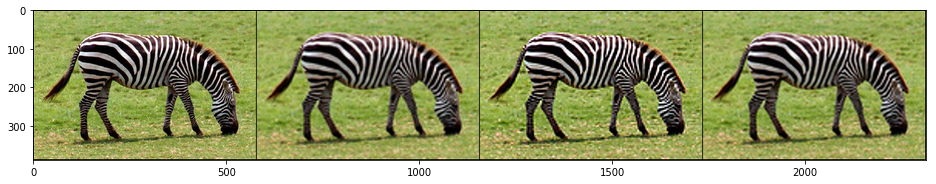

PSNR bicubic: 23.1048   PSNR lanczos: 23.5579
SSIM bicubic: 0.7930   SSIM lanczos: 0.8065


In [2]:
# Starts here
imgs = load_LR_HR_imgs_sr(path_to_image , imsize, factor, enforse_div32)

imgs['bicubic_np'], imgs['sharp_np'], imgs['lanczos_np'] = get_baselines(imgs['LR_pil'], imgs['HR_pil'])


psnr_bicubic = compare_psnr(imgs['HR_np'], imgs['bicubic_np'])
psnr_lanczos = compare_psnr(imgs['HR_np'], imgs['lanczos_np'])
ssim_bicubic = compare_ssim(np.transpose(imgs['HR_np'], (1, 2, 0)), np.transpose(imgs['bicubic_np'], (1, 2, 0)), multichannel=True)
ssim_lanczos = compare_ssim(np.transpose(imgs['HR_np'], (1, 2, 0)), np.transpose(imgs['lanczos_np'], (1, 2, 0)), multichannel=True)

if PLOT:
    plot_image_grid([imgs['HR_np'], imgs['bicubic_np'], imgs['sharp_np'], imgs['lanczos_np']], 4,12);
    print ('PSNR bicubic: %.4f   PSNR lanczos: %.4f' %  (psnr_bicubic, psnr_lanczos))
    print ('SSIM bicubic: %.4f   SSIM lanczos: %.4f' %  (ssim_bicubic, ssim_lanczos))

# Set up parameters and net

In [3]:
input_depth = 32
 
INPUT =     'noise'
pad   =     'reflection'
OPT_OVER =  'net'
KERNEL_TYPE='lanczos2'

LR = 0.01
tv_weight = 0.0

OPTIMIZER = 'adam'

if factor == 4: 
    num_iter = 2500
    reg_noise_std = 0.03
elif factor == 8:
    num_iter = 4000
    reg_noise_std = 0.05
else:
    assert False, 'We did not experiment with other factors'

In [4]:
net_input = get_noise(input_depth, INPUT, (imgs['HR_pil'].size[1], imgs['HR_pil'].size[0])).type(dtype).detach()

NET_TYPE = 'skip' # UNet, ResNet
# net = get_net(input_depth, 'skip', pad,
#               skip_n33d=128, 
#               skip_n33u=128, 
#               skip_n11=4, 
#               num_scales=5,
#               upsample_mode='bilinear').type(dtype)

net = SkipMaskGen(num_input_channels=32,
               num_output_channels=3,
               num_channels_down=[128, 128, 128, 128, 128],
               num_channels_up=[128, 128, 128, 128, 128],
               act_fun='ReLU').type(dtype)

net = net.cuda()
init_weights = net.state_dict()

In [5]:
net2 = SkipMaskApply(num_input_channels=32,
               num_output_channels=3,
               num_channels_down=[128, 128, 128, 128, 128],
               num_channels_up=[128, 128, 128, 128, 128],
               act_fun='ReLU').type(dtype)

net2 = net2.cuda()

net2.load_state_dict(init_weights)
net2_weights = net2.state_dict()

print(net2_weights['conv1_1.1.weight'])
print(init_weights['conv1_1.1.weight'])

tensor([[[[ 0.0369, -0.0009, -0.0369],
          [-0.0110,  0.0350, -0.0498],
          [-0.0462, -0.0165, -0.0534]],

         [[ 0.0199, -0.0022, -0.0133],
          [ 0.0272,  0.0411, -0.0080],
          [-0.0548, -0.0339, -0.0320]],

         [[ 0.0111,  0.0179,  0.0588],
          [-0.0355, -0.0441,  0.0531],
          [ 0.0168,  0.0503,  0.0143]],

         ...,

         [[-0.0499,  0.0569, -0.0278],
          [-0.0139, -0.0163, -0.0192],
          [ 0.0317, -0.0148,  0.0037]],

         [[-0.0549, -0.0162, -0.0391],
          [ 0.0562,  0.0578, -0.0541],
          [ 0.0530, -0.0046, -0.0146]],

         [[-0.0399, -0.0379, -0.0228],
          [-0.0134, -0.0144,  0.0120],
          [-0.0307, -0.0223, -0.0257]]],


        [[[-0.0208, -0.0367, -0.0487],
          [-0.0279, -0.0556,  0.0533],
          [ 0.0561, -0.0132, -0.0563]],

         [[-0.0566, -0.0098,  0.0579],
          [-0.0411, -0.0544, -0.0285],
          [-0.0022,  0.0004,  0.0519]],

         [[ 0.0242, -0.0391, -0

In [6]:
# Losses
mse = torch.nn.MSELoss().type(dtype)

img_LR_var = np_to_torch(imgs['LR_np']).type(dtype)

downsampler = Downsampler(n_planes=3, factor=factor, kernel_type=KERNEL_TYPE, phase=0.5, preserve_size=True).type(dtype)

# Define closure and optimize

In [7]:
def closure():
    global i, net_input
    
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)

#     out_HR = net(net_input)
    out_HR, _ = net(net_input)
    out_LR = downsampler(out_HR)

    total_loss = mse(out_LR, img_LR_var) 
    
    if tv_weight > 0:
        total_loss += tv_weight * tv_loss(out_HR)
        
    total_loss.backward()

    # Log
#     psnr_LR = compare_psnr(imgs['LR_np'], torch_to_np(out_LR))
    psnr_HR = compare_psnr(imgs['HR_np'], torch_to_np(out_HR))
#     print ('Iteration %05d    PSNR_LR %.3f   PSNR_HR %.3f' % (i, psnr_LR, psnr_HR), '\r', end='')
    
    ssim_HR = compare_ssim(np.transpose(imgs['HR_np'], (1, 2, 0)), np.transpose(torch_to_np(out_HR), (1, 2, 0)), multichannel=True)
    print ('Iteration %05d    PSNR_HR %.3f   SSIM_HR %.3f   Loss %.6f' % (i, psnr_HR, ssim_HR, total_loss.data), '\r', end='')
    
    if PLOT and (i % 100 == 0):
        psnr_history.append(psnr_HR)
        ssim_history.append(ssim_HR)
        iter_history.append(i)
        loss_history.append(total_loss.data)
        out_HR_np = torch_to_np(out_HR)
        plot_image_grid([imgs['HR_np'], imgs['bicubic_np'], imgs['lanczos_np'], np.clip(out_HR_np, 0, 1)], factor=8, nrow=2)

    i += 1
    
    return total_loss

Starting optimization with ADAM


/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:2351: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:2423: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


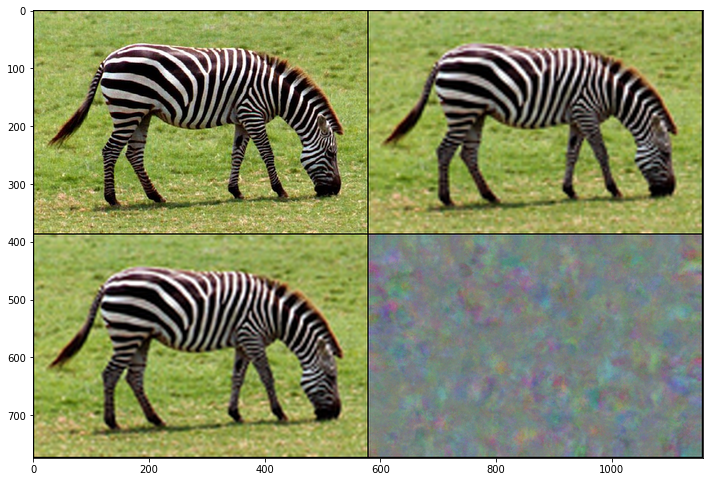

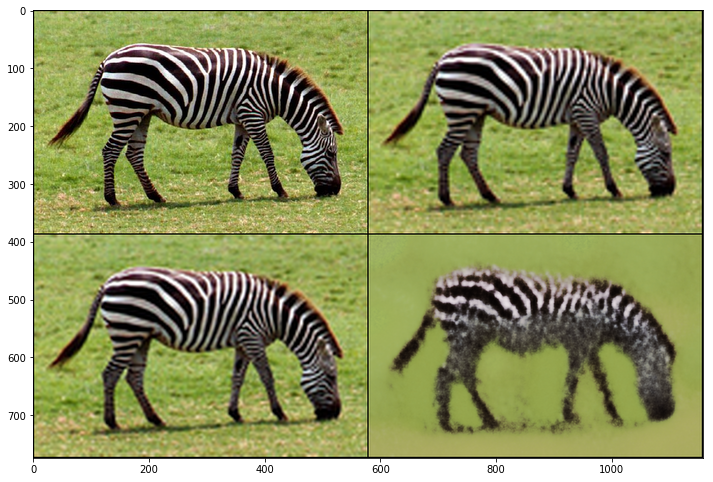

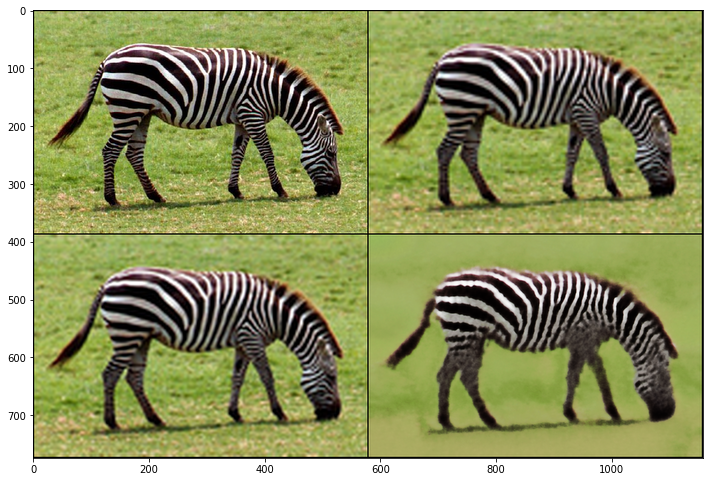

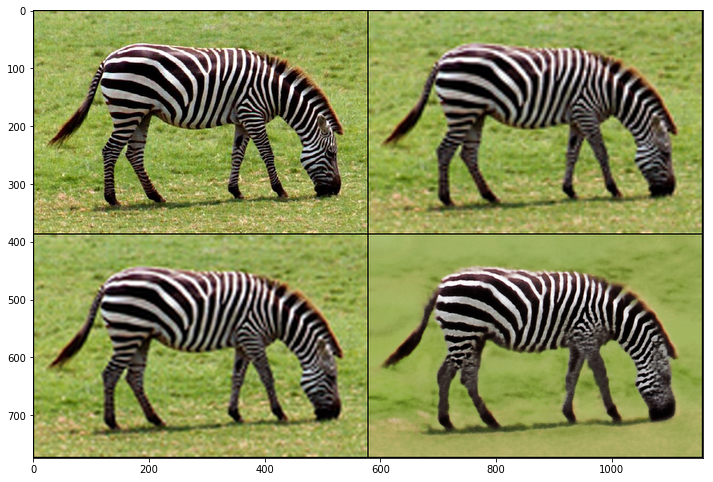

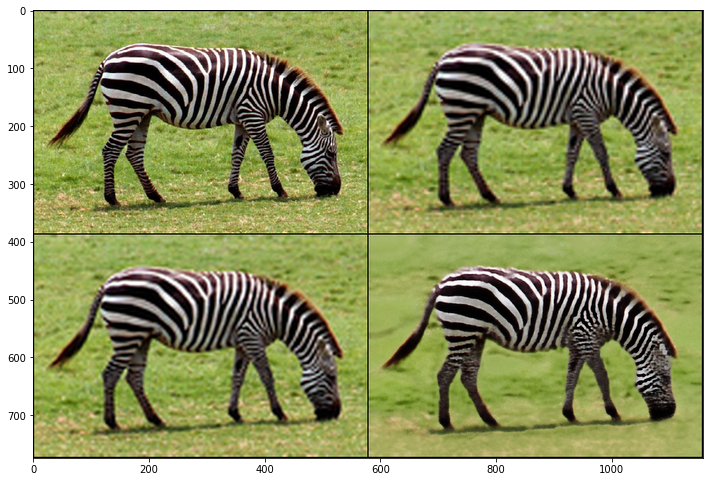

...

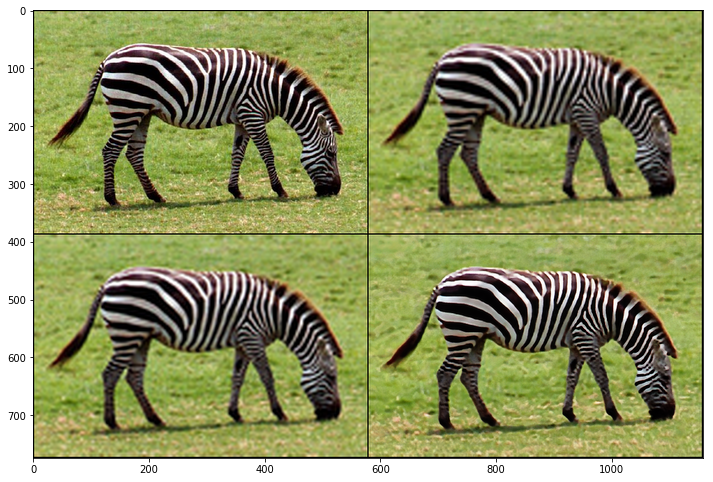

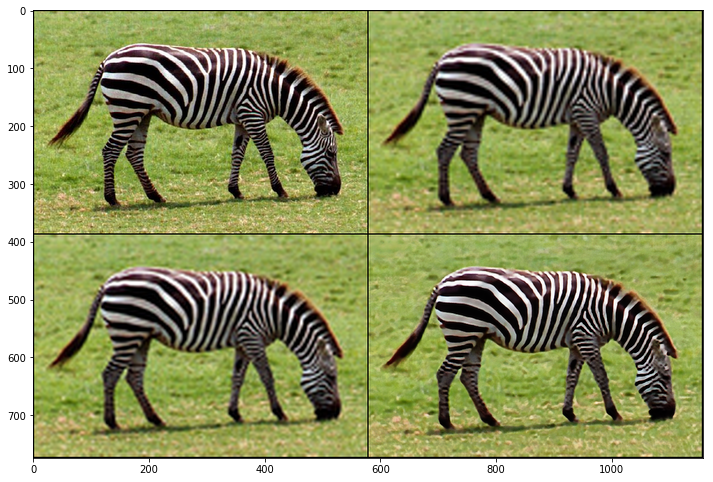

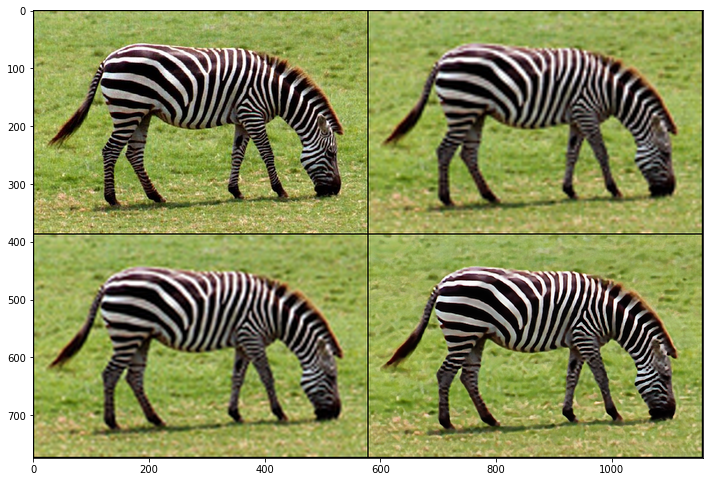

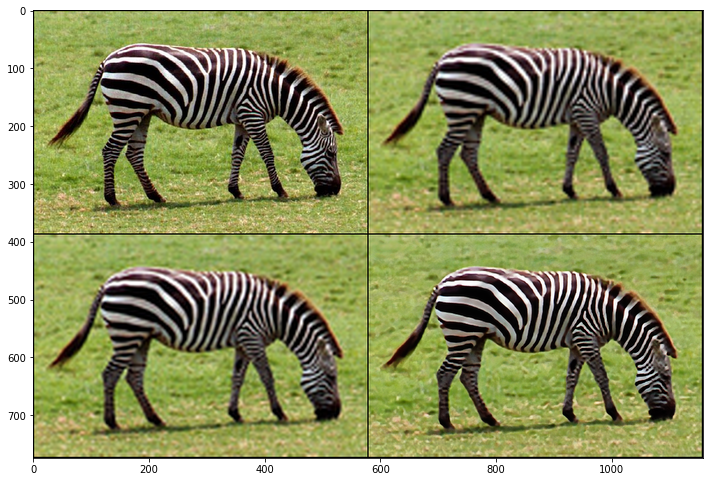

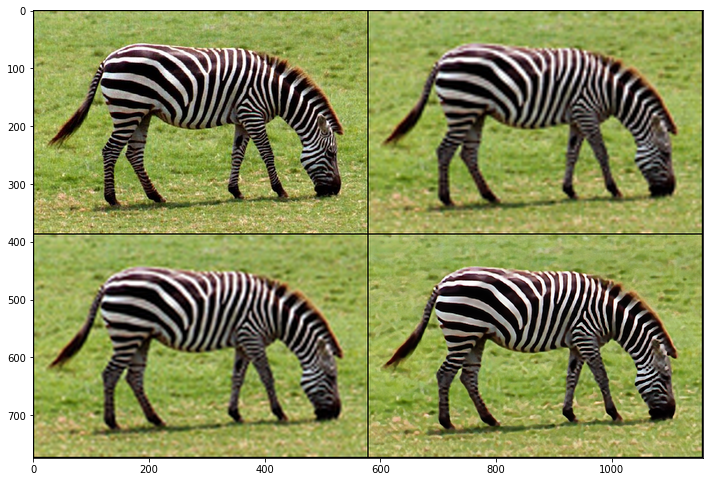

In [8]:
psnr_history = []
rmse_history = []
ssim_history = []
iter_history = []
loss_history = []
net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()

i = 0
p = get_params(OPT_OVER, net, net_input)
optimize(OPTIMIZER, p, closure, LR, num_iter)

/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:2351: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:2423: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


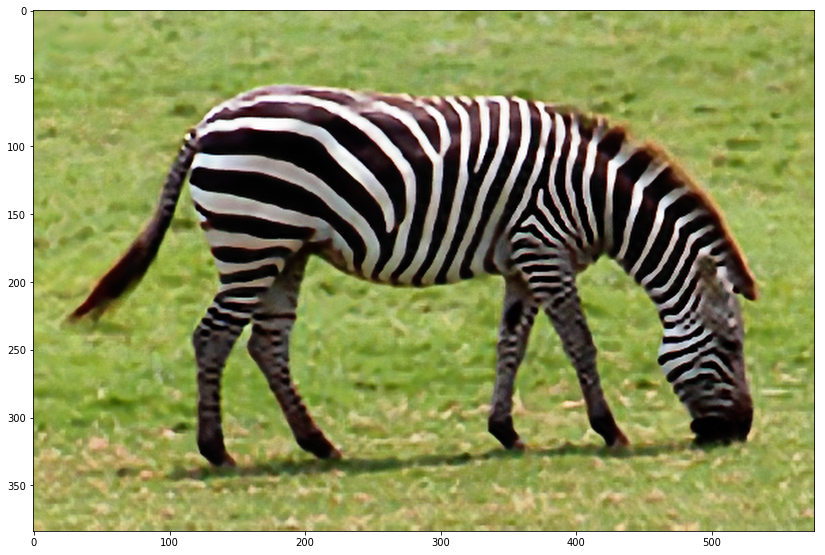

array([[[0.6509861 , 0.6610806 , 0.6497238 , ..., 0.62373227,
         0.6134076 , 0.6210959 ],
        [0.66061246, 0.66658443, 0.6607518 , ..., 0.6007176 ,
         0.617184  , 0.5904634 ],
        [0.6712244 , 0.6787091 , 0.6736854 , ..., 0.64801186,
         0.63200665, 0.6524875 ],
        ...,
        [0.73797417, 0.7496065 , 0.7295449 , ..., 0.6277465 ,
         0.6066848 , 0.6173446 ],
        [0.7550112 , 0.75863236, 0.7352654 , ..., 0.6109102 ,
         0.5941786 , 0.6025086 ],
        [0.7701876 , 0.77171063, 0.75153124, ..., 0.60424197,
         0.6056218 , 0.6048652 ]],

       [[0.70131636, 0.7031539 , 0.7073769 , ..., 0.6780368 ,
         0.6749057 , 0.6765181 ],
        [0.71167046, 0.70970947, 0.7080752 , ..., 0.6677428 ,
         0.6626768 , 0.6608257 ],
        [0.7292957 , 0.71311885, 0.7343016 , ..., 0.70069873,
         0.69961655, 0.7028924 ],
        ...,
        [0.67382914, 0.67853403, 0.6751586 , ..., 0.6880873 ,
         0.6635774 , 0.66443336],
        [0.6

In [9]:
output, mask_arr = net(net_input)
out_HR_np = np.clip(torch_to_np(output), 0, 1)

plot_image_grid([out_HR_np], factor=13, nrow=1)

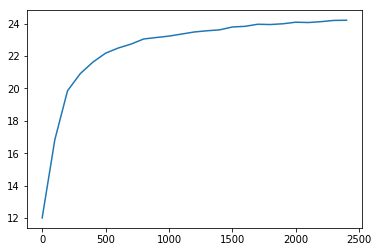

In [10]:
plt.plot(iter_history, psnr_history)

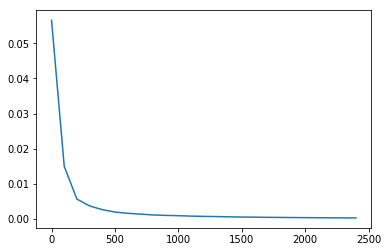

In [11]:
plt.plot(iter_history, loss_history)

In [12]:
def closure2():
    global i, net_input
    
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)

#     out_HR = net(net_input)
    out_HR = net2(net_input, mask_arr)
    out_LR = downsampler(out_HR)

    total_loss = mse(out_LR, img_LR_var) 
    
    if tv_weight > 0:
        total_loss += tv_weight * tv_loss(out_HR)
        
    total_loss.backward()

    # Log
#     psnr_LR = compare_psnr(imgs['LR_np'], torch_to_np(out_LR))
    psnr_HR = compare_psnr(imgs['HR_np'], torch_to_np(out_HR))
#     print ('Iteration %05d    PSNR_LR %.3f   PSNR_HR %.3f' % (i, psnr_LR, psnr_HR), '\r', end='')
    
    ssim_HR = compare_ssim(np.transpose(imgs['HR_np'], (1, 2, 0)), np.transpose(torch_to_np(out_HR), (1, 2, 0)), multichannel=True)
    print ('Iteration %05d    PSNR_HR %.3f   SSIM_HR %.3f   Loss %.6f' % (i, psnr_HR, ssim_HR, total_loss.data), '\r', end='')
    
    if PLOT and (i % 100 == 0):
        psnr_history.append(psnr_HR)
        ssim_history.append(ssim_HR)
        iter_history.append(i)
        loss_history.append(total_loss.data)
        out_HR_np = torch_to_np(out_HR)
        plot_image_grid([imgs['HR_np'], imgs['bicubic_np'], imgs['lanczos_np'], np.clip(out_HR_np, 0, 1)], factor=8, nrow=2)

    i += 1
    
    return total_loss

Starting optimization with ADAM


/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:2351: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:2423: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1332: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


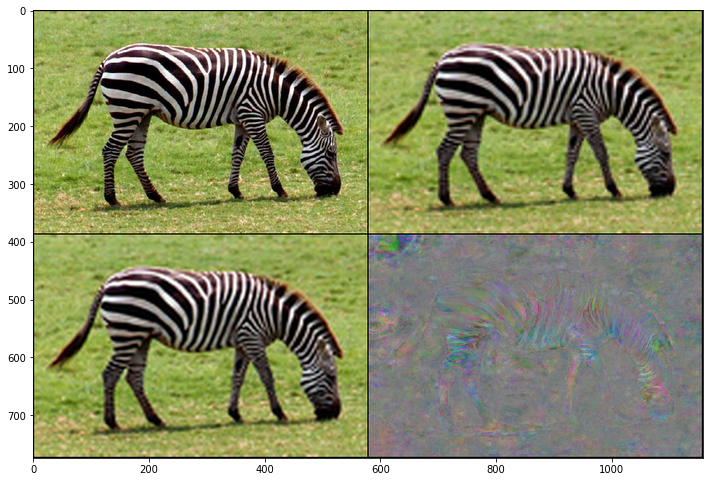

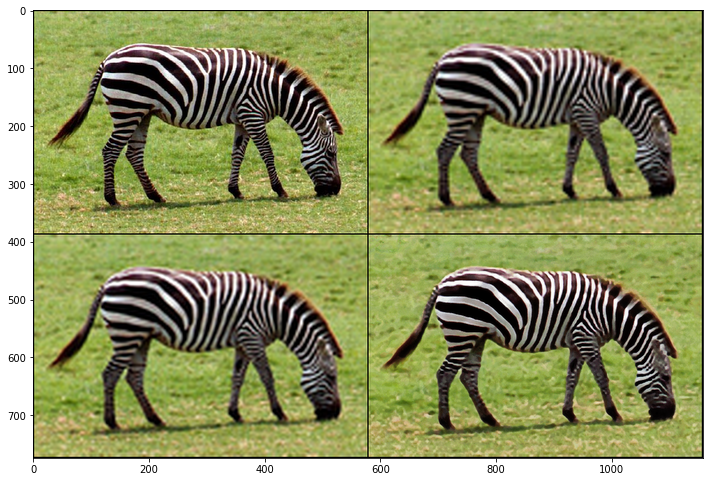

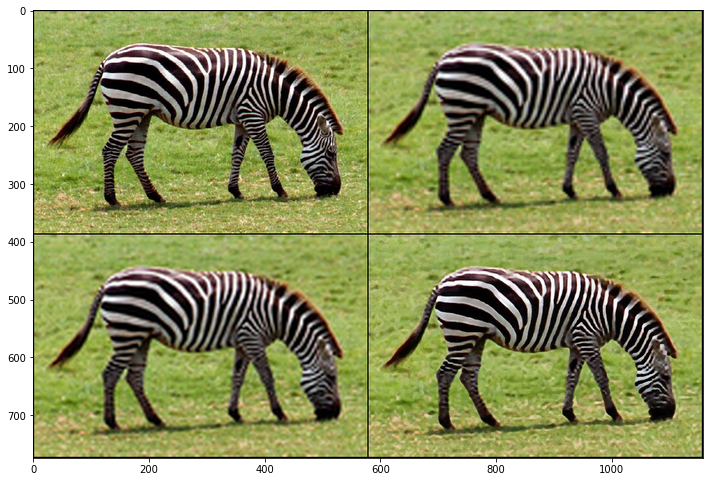

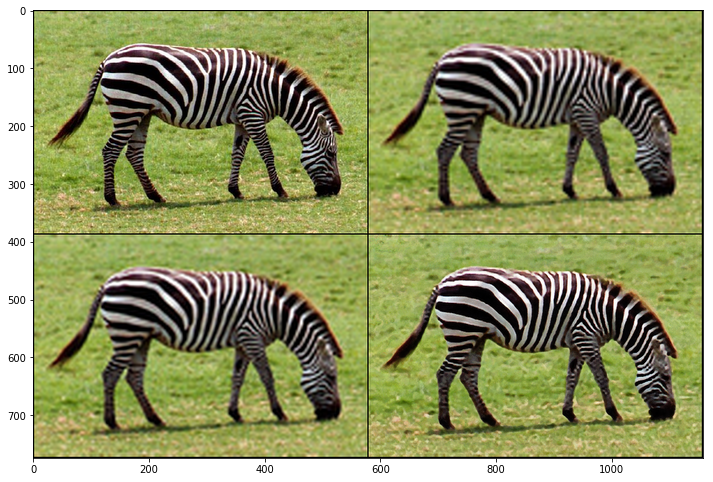

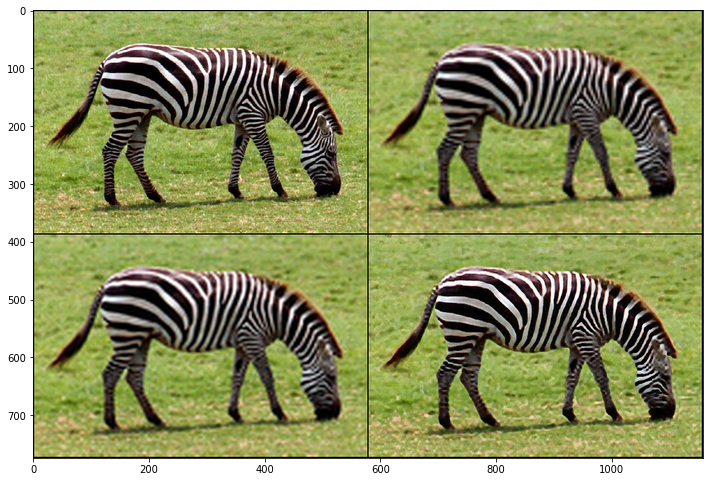

...

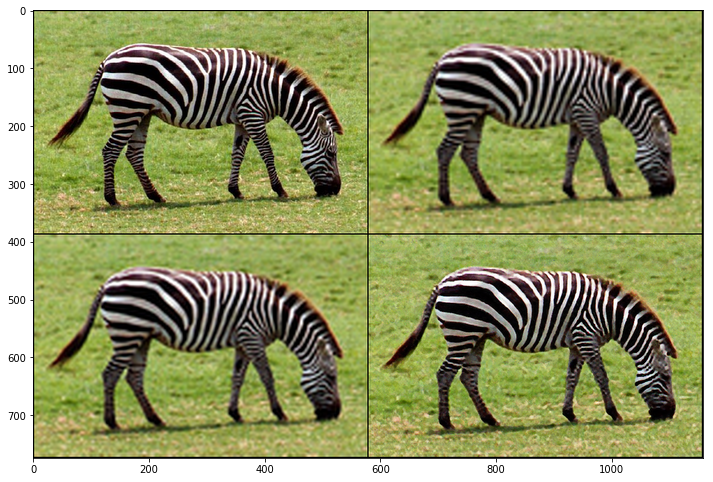

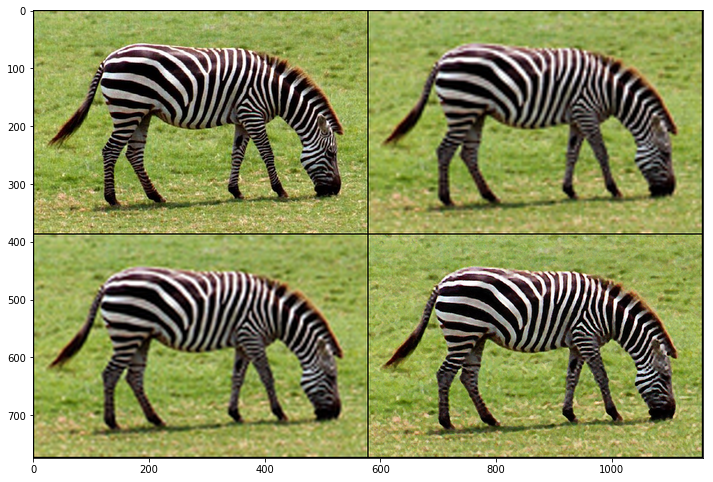

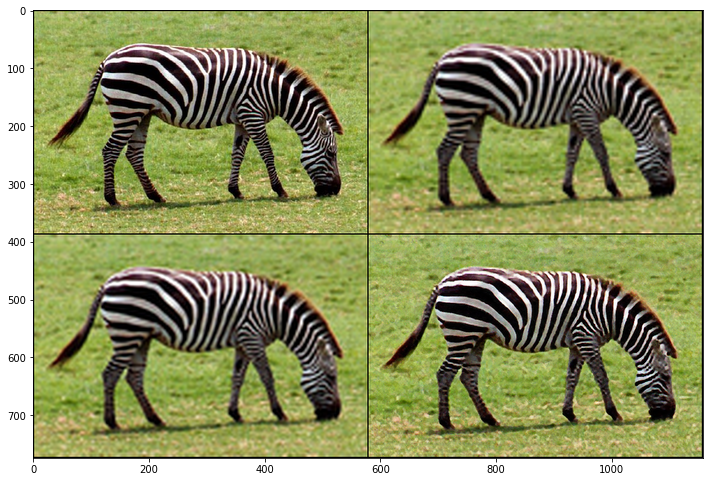

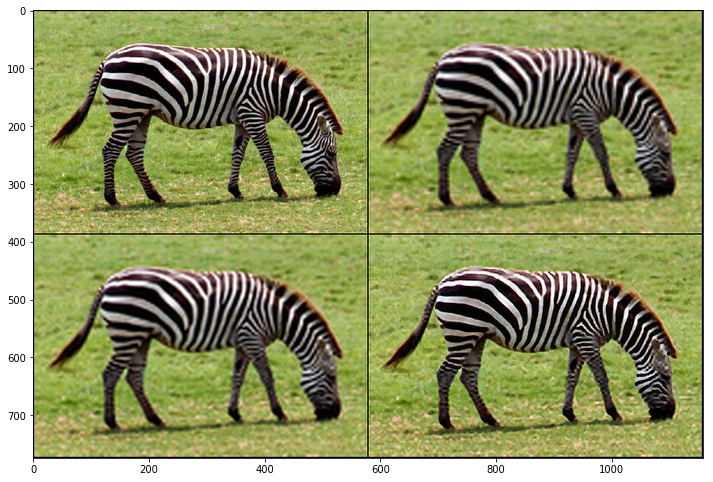

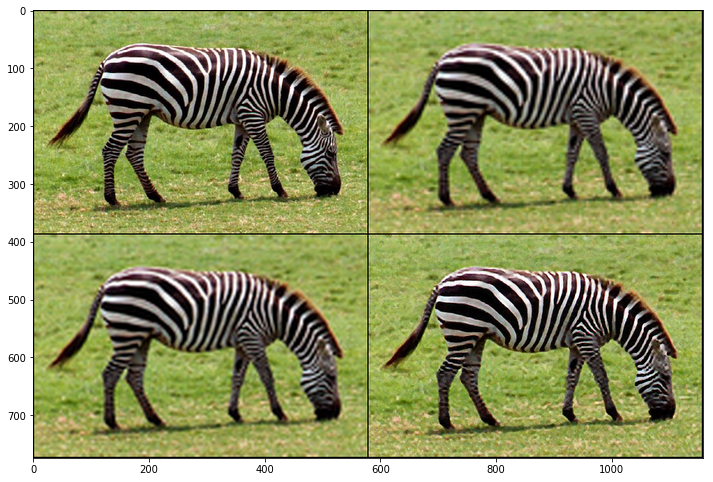

In [13]:
psnr_history = []
rmse_history = []
ssim_history = []
iter_history = []
loss_history = []
net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()

i = 0
p = get_params(OPT_OVER, net2, net_input)
optimize(OPTIMIZER, p, closure2, LR, num_iter)

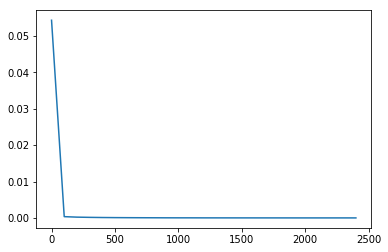

In [14]:
plt.plot(iter_history, loss_history)

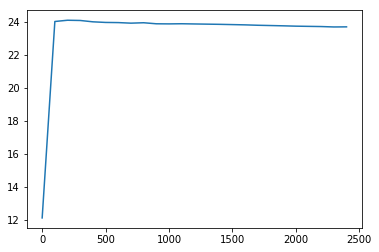

In [15]:
plt.plot(iter_history, psnr_history)